**EDA on training dataset 3**

- Data Set: FD003
- Train trjectories: 100
- Test trajectories: 100
- Conditions: ONE (Sea Level)
- Fault Modes: TWO (HPC Degradation, Fan Degradation)

~by Jyosna Philip

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

In [2]:
df=pd.read_csv(r"C:\Users\jyosn\Documents\GitHub\Predictive-Maintenance\Datasets\train_FD003.csv")
df.head()

,Engine,Cycles,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,Sensor6,Sensor7,Sensor8,...,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21,Sensor22,Sensor23,Sensor24,Remaining Cycles
0,1,1,-0.0005,0.0004,100.0,518.67,642.36,1583.23,1396.84,14.62,...,2388.01,8145.32,8.4246,0.03,391,2388,100.0,39.11,23.3537,258
1,1,2,0.0008,-0.0003,100.0,518.67,642.50,1584.69,1396.89,14.62,...,2388.03,8152.85,8.4403,0.03,392,2388,100.0,38.99,23.4491,257
2,1,3,-0.0014,-0.0002,100.0,518.67,642.18,1582.35,1405.61,14.62,...,2388.00,8150.17,8.3901,0.03,391,2388,100.0,38.85,23.3669,256
3,1,4,-0.0020,0.0001,100.0,518.67,642.92,1585.61,1392.27,14.62,...,2388.08,8146.56,8.3878,0.03,392,2388,100.0,38.96,23.2951,255
4,1,5,0.0016,0.0000,100.0,518.67,641.68,1588.63,1397.65,14.62,...,2388.03,8147.80,8.3869,0.03,392,2388,100.0,39.14,23.4583,254


In [3]:
df.shape

(24720, 27)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24720 entries, 0 to 24719
Data columns (total 27 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Engine            24720 non-null  int64  
 1   Cycles            24720 non-null  int64  
 2   Sensor1           24720 non-null  float64
 3   Sensor2           24720 non-null  float64
 4   Sensor3           24720 non-null  float64
 5   Sensor4           24720 non-null  float64
 6   Sensor5           24720 non-null  float64
 7   Sensor6           24720 non-null  float64
 8   Sensor7           24720 non-null  float64
 9   Sensor8           24720 non-null  float64
 10  Sensor9           24720 non-null  float64
 11  Sensor10          24720 non-null  float64
 12  Sensor11          24720 non-null  float64
 13  Sensor12          24720 non-null  float64
 14  Sensor13          24720 non-null  float64
 15  Sensor14          24720 non-null  float64
 16  Sensor15          24720 non-null  float6

In [13]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Engine,24720.0,48.631877,2.934899e+01,1.0000,23.0000,47.0000,74.0000,100.0000
Cycles,24720.0,139.077063,9.884668e+01,1.0000,62.0000,124.0000,191.0000,525.0000
Sensor1,24720.0,-0.000024,2.193545e-03,-0.0086,-0.0015,-0.0000,0.0015,0.0086
Sensor2,24720.0,0.000005,2.940429e-04,-0.0006,-0.0002,-0.0000,0.0003,0.0007
Sensor3,24720.0,100.000000,0.000000e+00,100.0000,100.0000,100.0000,100.0000,100.0000
Sensor4,24720.0,518.670000,0.000000e+00,518.6700,518.6700,518.6700,518.6700,518.6700
Sensor5,24720.0,642.457858,5.230311e-01,640.8400,642.0800,642.4000,642.7900,645.1100
Sensor6,24720.0,1588.079175,6.810418e+00,1564.3000,1583.2800,1587.5200,1592.4125,1615.3900
Sensor7,24720.0,1404.471212,9.773178e+00,1377.0600,1397.1875,1402.9100,1410.6000,1441.1600
Sensor8,24720.0,14.620000,3.552786e-15,14.6200,14.6200,14.6200,14.6200,14.6200


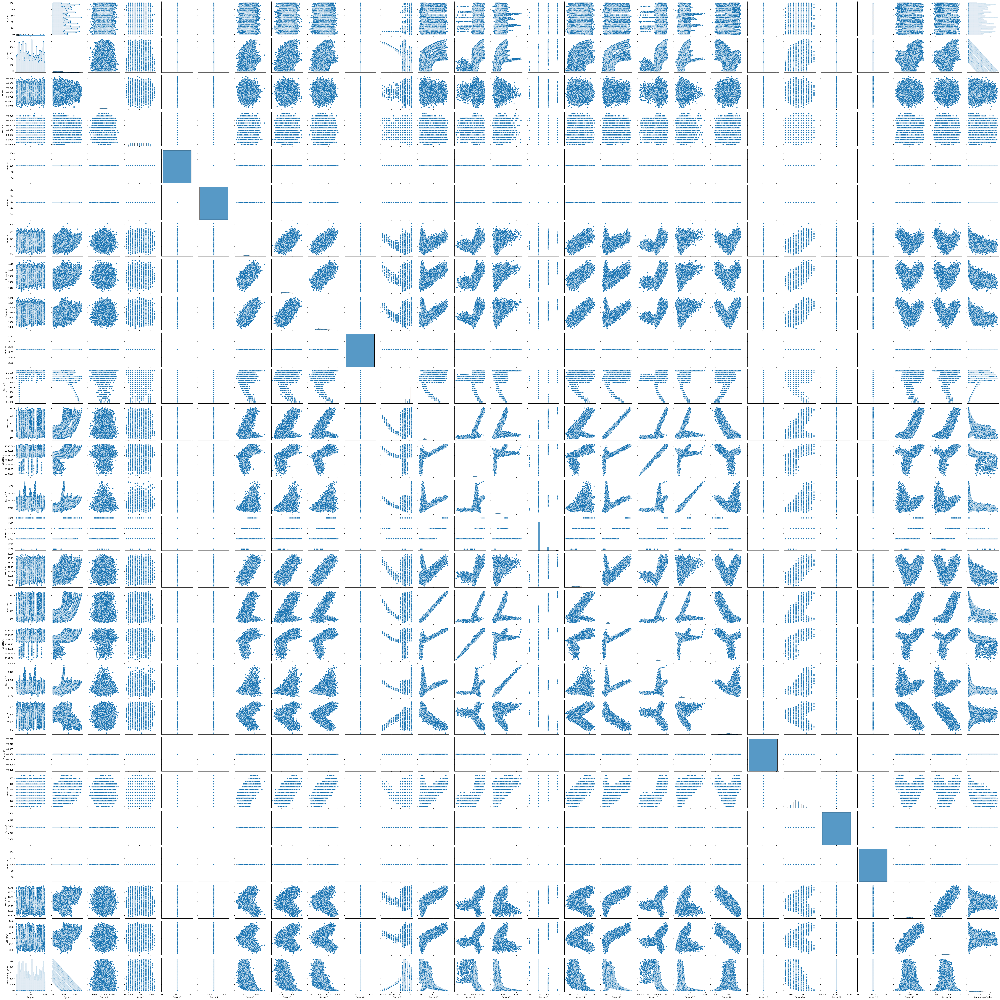

In [7]:
sns.pairplot(df)

<Axes: >

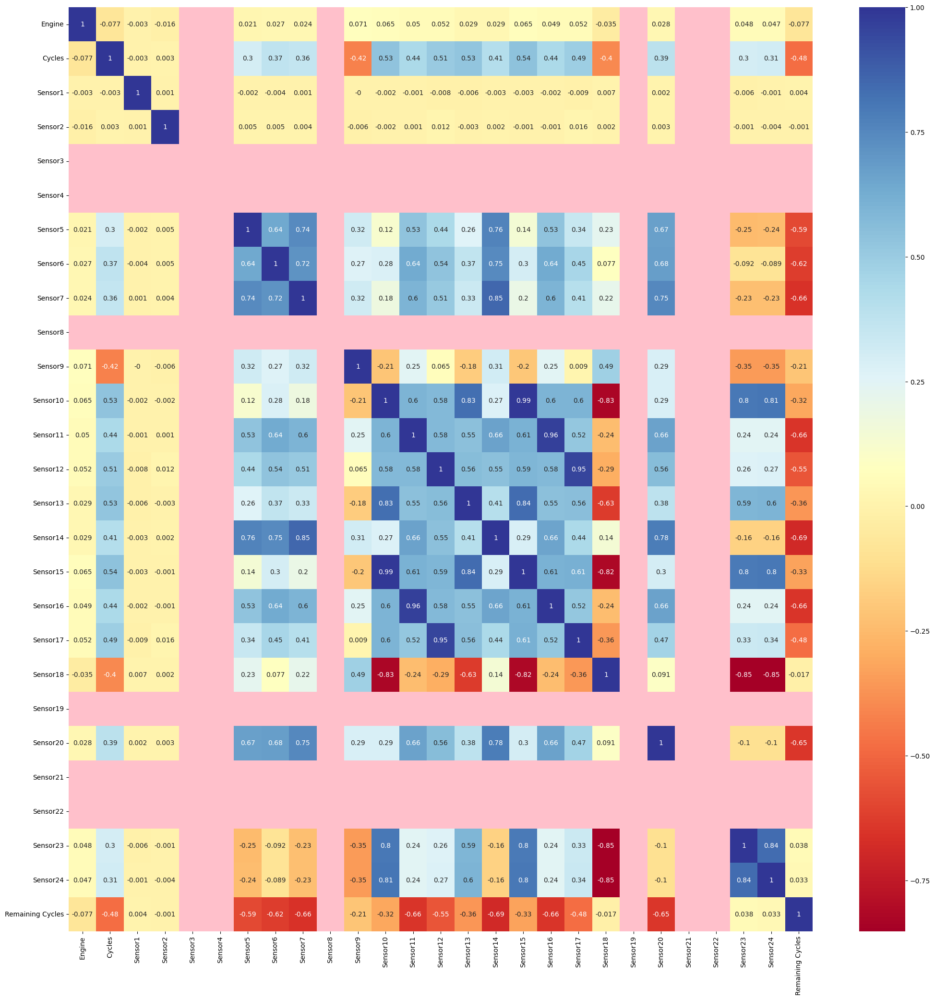

In [8]:
crm=df.corr().round(3)
fig=plt.figure(figsize=(25,25))
color = plt.get_cmap('RdYlBu')   # default color
color.set_bad('pink')  
sns.heatmap(crm,annot=True,cmap=color)

In [9]:
column=df.columns
column

Index(['Engine', 'Cycles', 'Sensor1', 'Sensor2', 'Sensor3', 'Sensor4',
       'Sensor5', 'Sensor6', 'Sensor7', 'Sensor8', 'Sensor9', 'Sensor10',
       'Sensor11', 'Sensor12', 'Sensor13', 'Sensor14', 'Sensor15', 'Sensor16',
       'Sensor17', 'Sensor18', 'Sensor19', 'Sensor20', 'Sensor21', 'Sensor22',
       'Sensor23', 'Sensor24', 'Remaining Cycles'],
      dtype='object')

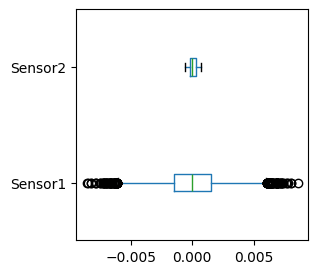

In [10]:
fig,ax=plt.subplots(figsize=(3,3))
k=2
df.iloc[:,2:4].boxplot(vert=False)
plt.grid(False)

In [11]:
import plotly.express as px

fig = px.parallel_coordinates(df.iloc[:,2:], color="Remaining Cycles",
                              color_continuous_scale=px.colors.diverging.delta_r,
                              color_continuous_midpoint=2,width=1200,height=1200,labels={'Sensor1':'S1', 'Sensor2':'S2', 'Sensor3':'S3', 'Sensor4':'S4',
       'Sensor5':'S5', 'Sensor6':'S6', 'Sensor7':'S7', 'Sensor8':'S8', 'Sensor9':'S9', 'Sensor10':'S10',
       'Sensor11':'S11', 'Sensor12':'S12', 'Sensor13':'S13', 'Sensor14':'S14', 'Sensor15':'S15', 'Sensor16':'S16',
       'Sensor17':'S17', 'Sensor18':'S18', 'Sensor19':'S19', 'Sensor20':'S20', 'Sensor21':'S21', 'Sensor22':'S22',
       'Sensor23':'S23', 'Sensor24':'S24', 'Remaining Cycles':'RC'})

fig.show()

<Axes: xlabel='Sensor1', ylabel='Remaining Cycles'>

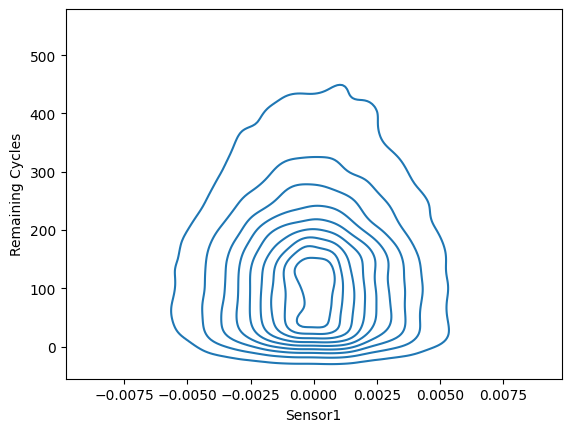

In [6]:
sns.kdeplot(df,x="Sensor1",y="Remaining Cycles")